# Topic modelling with spaCy and scikit-learn


Notebook:

https://www.kaggle.com/thebrownviking20/topic-modelling-with-spacy-and-scikit-learn




## Aim and Motivation

Nirant's latest kernel on spaCy: Hitchhiker's Guide to NLP in spaCy has made me realize that spaCy maybe as good or even better than NLTK for Natural Language Processing. My recent kernels deal with deep learning and I want to extend that by using text data for deep learning and intend to use spaCy for processing and modelling this data.



In [1]:
# Usual imports
import numpy as np
import pandas as pd
from tqdm import tqdm
import string
import matplotlib.pyplot as plt
from sklearn.decomposition import NMF, LatentDirichletAllocation, TruncatedSVD
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.manifold import TSNE
import concurrent.futures
import time
import pyLDAvis.sklearn
from pylab import bone, pcolor, colorbar, plot, show, rcParams, savefig
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline
import os
wine_data = os.getcwd() + "\\data\\input\\"
print(os.listdir(wine_data))


# Plotly based imports for visualization
import plotly
from plotly import tools
import plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff
plotly.tools.set_credentials_file(username=os.environ['PLOTLY_USERNAME'], api_key=os.environ['PLOTLY_API_KEY'])


# spaCy based imports
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
from spacy.lang.en import English

['winemag-data-130k-v2.csv', 'winemag-data-130k-v2.json', 'winemag-data_first150k.csv']


In [2]:
# Loading data
wines = pd.read_csv(wine_data + '\\winemag-data_first150k.csv')
wines.head()

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,US,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235.0,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
1,1,Spain,"Ripe aromas of fig, blackberry and cassis are ...",Carodorum Selección Especial Reserva,96,110.0,Northern Spain,Toro,NaN,Tinta de Toro,Bodega Carmen Rodríguez
2,2,US,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90.0,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,US,"This spent 20 months in 30% new French oak, an...",Reserve,96,65.0,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
4,4,France,"This is the top wine from La Bégude, named aft...",La Brûlade,95,66.0,Provence,Bandol,NaN,Provence red blend,Domaine de la Bégude


In [3]:
# Creating a spaCy object
nlp = spacy.load('en_core_web_lg')

spaCy also comes with a built-in named entity visualizer that lets you check your model's predictions in your browser. You can pass in one or more Doc objects and start a web server, export HTML files or view the visualization directly from a Jupyter Notebook.

## Named Entity Recognition

Named Entity Recognition is an information extraction task where named entities in unstructured sentences are located and classified in some pre-defined categories such as the person names, organizations, locations, medical codes, time expressions, quantities, monetary values, percentages, etc.


In [4]:
doc = nlp(wines["description"][3])
spacy.displacy.render(doc, style='ent',jupyter=True)

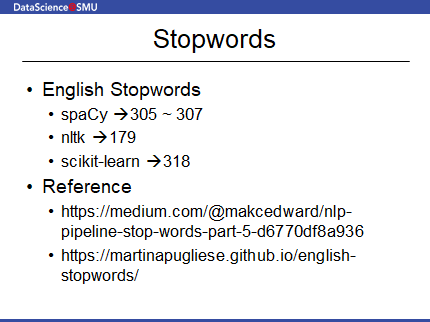

In [5]:
## Stopwords 

from IPython.display import Image
import os
Images = os.getcwd() + "\Images"
Image(filename= Images + '\StopWords.png')

In [6]:
punctuations = string.punctuation
stopwords = list(STOP_WORDS)

In [7]:
print("Number of Stop Words wrt to spaCy is: ", len(stopwords))

Number of Stop Words wrt to spaCy is:  305


## Lemmatization

It is the process of grouping together the inflected forms of a word so they can be analysed as a single item, identified by the word's lemma, or dictionary form. Words like "ran" and "running" are converted to "run" to avoid having words with similar meanings in our data.


In [8]:
review = str(" ".join([i.lemma_ for i in doc]))

In [9]:
doc = nlp(review)
spacy.displacy.render(doc, style='ent',jupyter=True)

The sentence looks much different now that it is lemmatized.

##  Parts of Speech tagging

This is the process of marking up a word in a text (corpus) as corresponding to a particular part of speech,[1] based on both its definition and its context—i.e., its relationship with adjacent and related words in a phrase, sentence, or paragraph. A simplified form of this is commonly taught to school-age children, in the identification of words as nouns, verbs, adjectives, adverbs, etc.


In [10]:
# POS tagging
for i in nlp(review):
    print(i,"=>",i.pos_)

this => DET
spend => NOUN
20 => NUM
month => NOUN
in => ADP
30 => NUM
% => NOUN
new => ADJ
french => ADJ
oak => NOUN
, => PUNCT
and => CCONJ
incorporate => VERB
fruit => NOUN
from => ADP
ponzi => NOUN
's => PART
aurora => NOUN
, => PUNCT
abetina => ADJ
and => CCONJ
madrona => NOUN
vineyard => NOUN
, => PUNCT
among => ADP
other => ADJ
. => PUNCT
aromatic => ADJ
, => PUNCT
dense => ADJ
and => CCONJ
toasty => ADJ
, => PUNCT
-PRON- => PUNCT
deftly => ADV
blend => VERB
aroma => NOUN
and => CCONJ
flavor => NOUN
of => ADP
toast => NOUN
, => PUNCT
cigar => NOUN
box => NOUN
, => PUNCT
blackberry => NOUN
, => PUNCT
black => ADJ
cherry => NOUN
, => PUNCT
coffee => NOUN
and => CCONJ
graphite => NOUN
. => PUNCT
tannin => NOUN
be => VERB
polish => NOUN
to => ADP
a => DET
fine => ADJ
sheen => NOUN
, => PUNCT
and => CCONJ
frame => VERB
a => DET
finish => NOUN
load => NOUN
with => ADP
dark => ADJ
chocolate => NOUN
and => CCONJ
espresso => NOUN
. => PUNCT
drink => VERB
now => ADV
through => ADP
2032 => 

In [11]:
# Parser for reviews
parser = English()
def spacy_tokenizer(sentence):
    mytokens = parser(sentence)
    mytokens = [ word.lemma_.lower().strip() if word.lemma_ != "-PRON-" else word.lower_ for word in mytokens ]
    mytokens = [ word for word in mytokens if word not in stopwords and word not in punctuations ]
    mytokens = " ".join([i for i in mytokens])
    return mytokens

In [12]:
tqdm.pandas()
wines["processed_description"] = wines["description"].progress_apply(spacy_tokenizer)

100%|█████████████████████████████████████████████████████████████████████████| 150930/150930 [05:07<00:00, 490.24it/s]


## What is topic-modelling?

In machine learning and natural language processing, a topic model is a type of statistical model for discovering the abstract "topics" that occur in a collection of documents. Topic modeling is a frequently used text-mining tool for discovery of hidden semantic structures in a text body. Intuitively, given that a document is about a particular topic, one would expect particular words to appear in the document more or less frequently: "dog" and "bone" will appear more often in documents about dogs, "cat" and "meow" will appear in documents about cats, and "the" and "is" will appear equally in both. A document typically concerns multiple topics in different proportions; thus, in a document that is 10% about cats and 90% about dogs, there would probably be about 9 times more dog words than cat words.

The "topics" produced by topic modeling techniques are clusters of similar words. A topic model captures this intuition in a mathematical framework, which allows examining a set of documents and discovering, based on the statistics of the words in each, what the topics might be and what each document's balance of topics is. It involves various techniques of dimensionality reduction(mostly non-linear) and unsupervised learning like LDA, SVD, autoencoders etc.

Source: Wikipedia


In [13]:
# Creating a vectorizer
vectorizer = CountVectorizer(min_df=5, max_df=0.9, stop_words='english', lowercase=True, token_pattern='[a-zA-Z\-][a-zA-Z\-]{2,}')
data_vectorized = vectorizer.fit_transform(wines["processed_description"])

In [14]:
NUM_TOPICS = 10

In [15]:
%%time

# Latent Dirichlet Allocation Model
lda = LatentDirichletAllocation(n_components=NUM_TOPICS, max_iter=10, learning_method='online',verbose=True)
data_lda = lda.fit_transform(data_vectorized)

iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10
Wall time: 10min 33s


In [16]:
%%time

# Non-Negative Matrix Factorization Model
nmf = NMF(n_components=NUM_TOPICS)
data_nmf = nmf.fit_transform(data_vectorized) 

Wall time: 31.2 s


In [17]:
%%time

# Latent Semantic Indexing Model using Truncated SVD
lsi = TruncatedSVD(n_components=NUM_TOPICS)
data_lsi = lsi.fit_transform(data_vectorized)

Wall time: 2.7 s


In [18]:
# Functions for printing keywords for each topic
def selected_topics(model, vectorizer, top_n=10):
    for idx, topic in enumerate(model.components_):
        print("Topic %d:" % (idx))
        print([(vectorizer.get_feature_names()[i], topic[i])
                        for i in topic.argsort()[:-top_n - 1:-1]]) 

In [19]:
# Keywords for topics clustered by Latent Dirichlet Allocation
print("LDA Model:")
selected_topics(lda, vectorizer)

LDA Model:
Topic 0:
[('flavor', 13910.311094472272), ('apple', 12503.60484448797), ('finish', 11589.27884017539), ('white', 11088.053936393517), ('peach', 10843.658325583567), ('fruit', 10629.221342077399), ('citrus', 10171.437361485016), ('wine', 9081.461594533948), ('note', 8274.27321615729), ('pear', 8203.489669157343)]
Topic 1:
[('spin-dry', 15632.972351278295), ('flavor', 13810.152980934701), ('wine', 11734.104416773636), ('acidity', 10631.654622354385), ('fruity', 6076.518678966786), ('good', 5535.3195415950295), ('crisp', 5504.079711976185), ('sweet', 5311.045480729165), ('nice', 5268.502963344812), ('balance', 5154.187032795508)]
Topic 2:
[('flavor', 21225.573792933817), ('cherry', 16123.842481384361), ('blackberry', 14150.855373020668), ('sweet', 11619.621155512392), ('wine', 9606.793063333103), ('chocolate', 8545.138742315943), ('oak', 8450.572577287261), ('tannin', 8033.477806100047), ('rich', 7091.5415339218225), ('black', 6346.908384489133)]
Topic 3:
[('cherry', 12793.1014

In [20]:
# Keywords for topics clustered by Latent Semantic Indexing
print("NMF Model:")
selected_topics(nmf, vectorizer)

NMF Model:
Topic 0:
[('flavor', 20.81952845224774), ('spin-dry', 2.2459451867874747), ('sweet', 1.7037379638296288), ('oak', 1.6616461555639146), ('vanilla', 1.0847685006851087), ('little', 1.0483342271945022), ('blackberry', 0.9726837433204013), ('finish', 0.9531256186562851), ('like', 0.8693193967876094), ('bite', 0.8677148848374735)]
Topic 1:
[('wine', 15.713752736014552), ('age', 0.9872316169436435), ('year', 0.7136357109960517), ('spice', 0.5784341734285087), ('character', 0.5204075225277413), ('structure', 0.5179454197918056), ('wood', 0.4835812233773158), ('texture', 0.4718759893684443), ('great', 0.4562303936064821), ('like', 0.342218832405483)]
Topic 2:
[('fruit', 16.496642194428624), ('red', 1.2711414203837506), ('wood', 0.6420905068234185), ('tropical', 0.6056650548437337), ('barrel', 0.5738016422463286), ('spice', 0.4918420190143807), ('stone', 0.479365152195368), ('oak', 0.4366380324636827), ('hint', 0.3890565771093833), ('age', 0.3869062248685764)]
Topic 3:
[('tannin', 10

In [21]:
# Keywords for topics clustered by Non-Negative Matrix Factorization
print("LSI Model:")
selected_topics(lsi, vectorizer)

LSI Model:
Topic 0:
[('wine', 0.46545443759708577), ('flavor', 0.37869474959866267), ('fruit', 0.348779378056952), ('finish', 0.18255713440491594), ('cherry', 0.1771505674010354), ('tannin', 0.15778296955056645), ('aroma', 0.15052435215445692), ('good', 0.14422784147493695), ('acidity', 0.14296701897846634), ('black', 0.1303079932501738)]
Topic 1:
[('wine', 0.6964235791945285), ('fruit', 0.16932650092504276), ('age', 0.0912572225867933), ('acidity', 0.06372731032942196), ('structure', 0.048577800393516196), ('year', 0.048278019016740635), ('wood', 0.0464815266398888), ('character', 0.040819555559468056), ('great', 0.030645638002628334), ('rich', 0.029708856592093342)]
Topic 2:
[('fruit', 0.7154726307587135), ('black', 0.1628907681170831), ('tannin', 0.11289922982540755), ('palate', 0.10284083615575716), ('aroma', 0.09492634935317329), ('note', 0.08377020183975617), ('berry', 0.07031491758661514), ('dark', 0.06660692106307047), ('finish', 0.06488066701944473), ('red', 0.0645523170311320

In [22]:
# Transforming an individual sentence
text = spacy_tokenizer("Aromas include tropical fruit, broom, brimstone and dried herb. The palate isn't overly expressive, offering unripened apple, citrus and dried sage alongside brisk acidity.")
x = lda.transform(vectorizer.transform([text]))[0]
print(x)

[0.45736211 0.00500124 0.13553722 0.00500019 0.37209658 0.00500006
 0.00500105 0.00500004 0.00500053 0.00500099]


The index in the above list with the largest value represents the most dominant topic for the given review.

# Visualizing LDA results with pyLDAvis

In [23]:
pyLDAvis.enable_notebook()
dash = pyLDAvis.sklearn.prepare(lda, data_vectorized, vectorizer, mds='tsne')
dash

PreparedData(topic_coordinates=                x           y  topics  cluster       Freq
topic                                                    
4       88.182388   50.111843       1        1  14.882259
0     -145.332550  223.100952       2        1  14.737290
8       66.445000  237.584213       3        1  14.560034
2     -175.278595 -175.944839       4        1  11.915485
6     -271.576538   14.820388       5        1   9.295164
3      263.687714   95.580406       6        1   8.803692
1      -90.226166   46.856087       7        1   7.965380
9       41.439323 -282.493378       8        1   6.540726
5        1.942605 -105.965843       9        1   5.700656
7      205.980774 -122.902145      10        1   5.599315, topic_info=      Category          Freq        Term         Total  loglift  logprob
term                                                                    
1837   Default  40235.000000      cherry  40235.000000  30.0000  30.0000
9354   Default  23022.000000    spin-dry  23022.000000  29.0000  29.0000
6826   Default  21064.000000         oak  21064.000000  28.0000  28.0000
11163  Default  95345.000000        wine  95345.000000  27.0000  27.0000
7109   Default  27795.000000      palate  27795.000000  26.0000  26.0000
89     Default  30364.000000     acidity  30364.000000  25.0000  25.0000
514    Default  34153.000000       aroma  34153.000000  24.0000  24.0000
3893   Default  84664.000000      flavor  84664.000000  23.0000  23.0000
9939   Default  33227.000000      tannin  33227.000000  22.0000  22.0000
11260  Default  16174.000000        year  16174.000000  21.0000  21.0000
9837   Default  23142.000000       sweet  23142.000000  20.0000  20.0000
990    Default  18981.000000  blackberry  18981.000000  19.0000  19.0000
5736   Default  11260.000000      little  11260.000000  18.0000  18.0000
5663   Default  11744.000000       light  11744.000000  17.0000  17.0000
986    Default  25392.000000       black  25392.000000  16.0000  16.0000
4412   Default  32868.000000        good  32868.000000  15.0000  15.0000
7470   Default   9468.000000       pinot   9468.000000  14.0000  14.0000
3830   Default  42253.000000      finish  42253.000000  13.0000  13.0000
179    Default  13653.000000         age  13653.000000  12.0000  12.0000
446    Default  13671.000000       apple  13671.000000  11.0000  11.0000
7238   Default  10898.000000       peach  10898.000000  10.0000  10.0000
923    Default  21550.000000       berry  21550.000000   9.0000   9.0000
10895  Default   7716.000000    vineyard   7716.000000   8.0000   8.0000
2533   Default  14208.000000       crisp  14208.000000   7.0000   7.0000
11117  Default  12118.000000       white  12118.000000   6.0000   6.0000
1952   Default  12575.000000      citrus  12575.000000   5.0000   5.0000
1777   Default   6527.000000  chardonnay   6527.000000   4.0000   4.0000
1017   Default  15377.000000       blend  15377.000000   3.0000   3.0000
6771   Default  16313.000000        nose  16313.000000   2.0000   2.0000
1890   Default  12611.000000   chocolate  12611.000000   1.0000   1.0000
...        ...           ...         ...           ...      ...      ...
3107   Topic10    805.985750         dre    806.877731   2.8814  -5.4693
6502   Topic10    801.946329       mourv    802.838310   2.8814  -5.4743
860    Topic10    774.257123        beer    775.149164   2.8814  -5.5094
9293   Topic10    748.281315    southern    749.173390   2.8813  -5.5436
9770   Topic10    716.256975   superripe    717.149121   2.8813  -5.5873
11169  Topic10    630.250028  winemaking    631.142099   2.8811  -5.7152
8640   Topic10    629.522071       santa    630.414089   2.8811  -5.7164
2521   Topic10    620.343744       creek    621.235805   2.8811  -5.7311
3676   Topic10    605.154426         fan    606.046593   2.8811  -5.7559
7554   Topic10    603.457850      plummy    604.349967   2.8810  -5.7587
2459   Topic10    590.615862      county    591.507882   2.8810  -5.7802
1448   Topic10    569.974827        cabs    570.8

# How to interpret this graph?

    1. Topics on the left while their respective keywords are on the right.
    2. Larger topics are more frequent and closer the topics, mor the similarity
    3. Selection of keywords is based on their frequency and discriminancy.

Hover over the topics on the left to get information about their keywords on the right.


## Visualizing LSI(SVD) scatterplot

We will be visualizing our data for 2 topics to see similarity between keywords which is measured by distance with the markers 

In [24]:
svd_2d = TruncatedSVD(n_components=2)
data_2d = svd_2d.fit_transform(data_vectorized)

In [25]:
# Plotly based imports for visualization
import plotly
from plotly import tools
import plotly.plotly as py
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.figure_factory as ff
plotly.tools.set_credentials_file(username=os.environ['PLOTLY_USERNAME'], api_key=os.environ['PLOTLY_API_KEY'])

In [26]:
trace = go.Scattergl(
    x = data_2d[:,0],
    y = data_2d[:,1],
    mode = 'markers',
    marker = dict(
        color = '#FFBAD2',
        line = dict(width = 1)
    ),
    text = vectorizer.get_feature_names(),
    hovertext = vectorizer.get_feature_names(),
    hoverinfo = 'text' 
)
data = [trace]
iplot(data, filename='scatter-mode')

## The text version of scatter plot looks messy but you can zoom it for great results

In [27]:
trace = go.Scattergl(
    x = data_2d[:,0],
    y = data_2d[:,1],
    mode = 'text',
    marker = dict(
        color = '#FFBAD2',
        line = dict(width = 1)
    ),
    text = vectorizer.get_feature_names()
)
data = [trace]
iplot(data, filename='text-scatter-mode')

## Let's see what happens when we use a spaCy based bigram tokenizer for topic modelling

In [28]:
def spacy_bigram_tokenizer(phrase):
    doc = parser(phrase) # create spacy object
    token_not_noun = []
    notnoun_noun_list = []
    noun = ""

    for item in doc:
        if item.pos_ != "NOUN": # separate nouns and not nouns
            token_not_noun.append(item.text)
        if item.pos_ == "NOUN":
            noun = item.text
        
        for notnoun in token_not_noun:
            notnoun_noun_list.append(notnoun + " " + noun)

    return " ".join([i for i in notnoun_noun_list])

In [29]:
bivectorizer = CountVectorizer(min_df=5, max_df=0.9, stop_words='english', lowercase=True, ngram_range=(1,2))
bigram_vectorized = bivectorizer.fit_transform(wines["processed_description"])

## LDA for bigram data

In [30]:
bi_lda = LatentDirichletAllocation(n_components=NUM_TOPICS, max_iter=10, learning_method='online',verbose=True)
data_bi_lda = bi_lda.fit_transform(bigram_vectorized)

iteration: 1 of max_iter: 10
iteration: 2 of max_iter: 10
iteration: 3 of max_iter: 10
iteration: 4 of max_iter: 10
iteration: 5 of max_iter: 10
iteration: 6 of max_iter: 10
iteration: 7 of max_iter: 10
iteration: 8 of max_iter: 10
iteration: 9 of max_iter: 10
iteration: 10 of max_iter: 10


## Topics for bigram model

In [31]:
print("Bi-LDA Model:")
selected_topics(bi_lda, bivectorizer)

Bi-LDA Model:
Topic 0:
[('aroma', 8171.939114567469), ('spice', 5809.372571449917), ('offer', 5331.169147038662), ('cherry', 4350.678353529048), ('note', 3607.7317295601993), ('open', 3076.261797879477), ('berry', 2876.2881402200137), ('close', 2599.526877954569), ('wine', 2557.8525887518463), ('deliver', 2555.2060764423277)]
Topic 1:
[('dry', 14297.620689602543), ('crisp', 13728.049126273025), ('acidity', 12764.28572779791), ('wine', 11967.411192831361), ('flavor', 11491.437014572175), ('fresh', 11375.161327465637), ('citrus', 11245.942104056649), ('spin', 11236.000061966615), ('spin dry', 11105.957606335078), ('white', 10285.785013975243)]
Topic 2:
[('berry', 16447.15814347084), ('flavor', 11793.595809772707), ('palate', 11610.35546401836), ('fruit', 11603.643944363883), ('finish', 11589.807150406763), ('aroma', 11542.877887689086), ('plum', 11348.854561666963), ('red', 9619.187697616971), ('cherry', 7174.890042967764), ('nose', 6943.665781579269)]
Topic 3:
[('wine', 34993.8473025904

In [32]:
bi_dash = pyLDAvis.sklearn.prepare(bi_lda, bigram_vectorized, bivectorizer, mds='tsne')
bi_dash

PreparedData(topic_coordinates=                x          y  topics  cluster       Freq
topic                                                   
1      -39.250053 -93.482010       1        1  13.225850
3       46.148270 -16.424147       2        1  12.999695
9      -55.136723  52.979729       3        1  12.392092
4      101.286491 -44.021984       4        1  10.765209
2       -9.881477 -39.499573       5        1  10.547634
5       82.135796  36.328007       6        1  10.093646
6       23.638344  78.068069       7        1   9.955451
8      -71.294212 -18.118776       8        1   8.470337
0       39.004120 -87.931938       9        1   6.152744
7       -1.750967  20.607227      10        1   5.397343, topic_info=       Category          Freq          Term         Total  loglift  logprob
term                                                                       
19345   Default  39731.000000        cherry  39731.000000  30.0000  30.0000
11386   Default  19055.000000    blackberry  19055.000000  29.0000  29.0000
6094    Default  34013.000000         aroma  34013.000000  28.0000  28.0000
10030   Default  21374.000000         berry  21374.000000  27.0000  27.0000
111341  Default  94610.000000          wine  94610.000000  26.0000  26.0000
73402   Default  27360.000000        palate  27360.000000  25.0000  25.0000
100898  Default  33041.000000        tannin  33041.000000  24.0000  24.0000
38333   Default  41317.000000        finish  41317.000000  23.0000  23.0000
99115   Default  22759.000000         sweet  22759.000000  22.0000  22.0000
26300   Default  14309.000000         crisp  14309.000000  21.0000  21.0000
11293   Default  24877.000000         black  24877.000000  20.0000  20.0000
31592   Default  32536.000000           dry  32536.000000  19.0000  19.0000
3483    Default  13860.000000           age  13860.000000  18.0000  18.0000
39752   Default  83852.000000        flavor  83852.000000  17.0000  17.0000
16054   Default  11392.000000      cabernet  11392.000000  16.0000  16.0000
94958   Default  22965.000000          spin  22965.000000  15.0000  15.0000
2243    Default  30575.000000       acidity  30575.000000  14.0000  14.0000
94962   Default  22761.000000      spin dry  22761.000000  13.0000  13.0000
43924   Default  72636.000000         fruit  72636.000000  12.0000  12.0000
77657   Default  15107.000000          plum  15107.000000  11.0000  11.0000
83972   Default  21597.000000          rich  21597.000000  10.0000  10.0000
20856   Default  12531.000000        citrus  12531.000000   9.0000   9.0000
92492   Default  17901.000000          soft  17901.000000   8.0000   8.0000
59787   Default  10845.000000        little  10845.000000   7.0000   7.0000
5429    Default  13433.000000         apple  13433.000000   6.0000   6.0000
11930   Default  14604.000000         blend  14604.000000   5.0000   5.0000
68633   Default  15963.000000          nose  15963.000000   4.0000   4.0000
110995  Default  12168.000000         white  12168.000000   3.0000   3.0000
114183  Default  16391.000000          year  16391.000000   2.0000   2.0000
81888   Default  11656.000000     raspberry  11656.000000   1.0000   1.0000
...         ...           ...           ...           ...      ...      ...
52653   Topic10    504.354394        impart    505.243987   2.9175  -6.4612
22180   Topic10    488.856319         coast    489.745756   2.9174  -6.4924
99669   Topic10    482.094188       sweetly    482.983759   2.9174  -6.5063
81857   Topic10    475.451097          rare    476.340615   2.9174  -6.5202
84741   Topic10    461.004042          ride    461.893662   2.9173  -6.5510
78583   Topic10    421.946721       popular    422.836175   2.9172  -6.6396
86747   Topic10    421.486736     roussanne    422.376143   2.9172  -6.6406
113314  Topic10   2556.582206        winery   3107.611237   2.7241  -4.8380
47765   Topic10   4151.406488         grape   5776.416478   2.5889  -4.3532
108001  Topic10   1830.688941       variety   2648.597526   2.5499  -5.1720
96320

# Results

### Very few keywords with 2 words have been found like "spin dry" , "black cherry", etc.


In [55]:
#environment and package versions
print('\n')
print("_"*70)
print('The environment and package versions used in this script are:')
print('\n')

import platform
import sys
import bs4
from bs4 import BeautifulSoup
import urllib
import re
import textacy
import spacy
import gensim
import sklearn
import scipy
import matplotlib
import cufflinks as cf
import IPython
import mglearn

print(platform.platform())
print('Python', sys.version)
print("pandas version:", pd.__version__)
print('OS', os.name)
print('Numpy', np.__version__)
print('Beautiful Soup', bs4.__version__)
print('Urllib', urllib.request.__version__) 
print('Regex', re.__version__)
print('Textacy', textacy.__version__)
print('spaCy', spacy.__version__)
print('gensim', gensim.__version__)
print('scikit-learn version', sklearn.__version__)
print('scipy', scipy.__version__)
print('matplotlib', matplotlib.__version__)
print('plotly', plotly.__version__)
print('Cufflinks', cf.__version__)
print("IPython version:", IPython.__version__)
print("mglearn version:", mglearn.__version__)
print ("Anaconda Python Environment is: ", os.environ['CONDA_DEFAULT_ENV'])

print('\n')
print("~"*70)
print('\n')



______________________________________________________________________
The environment and package versions used in this script are:


Windows-10-10.0.17134-SP0
Python 3.6.6 |Anaconda custom (64-bit)| (default, Jun 28 2018, 11:27:44) [MSC v.1900 64 bit (AMD64)]
pandas version: 0.23.4
OS nt
Numpy 1.15.4
Beautiful Soup 4.6.3
Urllib 3.6
Regex 2.2.1
Textacy 0.6.2
spaCy 2.0.12
gensim 3.5.0
scikit-learn version 0.19.2
scipy 1.1.0
matplotlib 2.2.2
plotly 3.4.2
Cufflinks 0.12.1
IPython version: 6.5.0
mglearn version: 0.1.7
Anaconda Python Environment is:  py36_text_analytics


~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


